In [84]:
using LinearAlgebra;
using SpecialFunctions;
using ControlSystems;
using Plots;
using VectorizedRoutines.Matlab: meshgrid

## LegT Measure


In [85]:
function build_LegT(N::Integer, λ_n::Integer=1, theta::Real=1)
    k, n = meshgrid([0:N-1;], [0:N-1;])
    case = (-1) .^ (n - k)
    A = Matrix{Float64}(undef, N, N)
    B = Matrix{Float64}(undef, 1, N)

    if λ_n == 1
        A_base = sqrt.(2 .* n .+ 1) .* sqrt.(2 .* k .+ 1)
        pre_D = sqrt.(diagm(0 => (2 .* [0:N-1;] .+ 1)))
        B = D = diag(pre_D, 0)
        A = ifelse.(
            k .<= n,
            A_base, 
            A_base .* case
            )  # if n >= k, then case_2 * A_base is used, otherwise A_base

    elseif λ_n == 2
        A_base = (2 .* n .+ 1)
        pre_B = (2 .* [0:N-1;] .+ 1) .* ((-1) .^ n)
        B = diag(Diagonal(pre_B), 0)
        A = ifelse.(
            n .>= k, 
            A_base .* case, 
            A_base
            )  # if n >= k, then case_2 * A_base is used, otherwise A_base
    else
        error("lambda must be 1 or 2")

    end

    A = -inv(theta) .* A

    return A, B
end

build_LegT (generic function with 3 methods)

## LagT Measure


In [86]:
function build_LagT(N::Integer, alpha::Real=0, beta::Real=1)
    A = Matrix{Float64}(undef, N, N)
    B = Matrix{Float64}(undef, 1, N)

    L = exp.(0.5 .* (loggamma.(([0:N-1;] .+ alpha .+ 1)) .- loggamma.([0:N-1;] .+ 1)))
    pre_inv_L = diag(Diagonal(L), 0)
    # display("text/plain", pre_inv_L)
    inv_L = inv.(pre_inv_L)
    # display("text/plain", inv_L)

    # display("text/plain", (I .* ((1 .+ beta) ./ 2)))
    pre_Aa = (Matrix(1.0I, N, N) .* ((1 .+ beta) ./ 2))
    pre_Ab = tril(ones(N, N), -1)
    pre_A = pre_Aa .+ pre_Ab
    # display("text/plain", (binomial.((alpha .+ [0:N-1;]), [0:N-1;])))
    pre_B =  diag(diagm(0 => (binomial.((alpha .+ [0:N-1;]), [0:N-1;]))))
    A = -inv_L .* pre_A .* pre_inv_L
    B = (
        exp.((-0.5) .* loggamma.(1 .- alpha))
        .* (beta .^ ((1 .- alpha) ./ 2))
        .* inv_L
        .* pre_B
    )

    return A, B
end

build_LagT (generic function with 3 methods)

## LegS Measure

In [87]:
function build_LegS(N::Integer)
    k, n = meshgrid([0:N-1;], [0:N-1;])
    pre_D = sqrt.(diagm(0 => (2 .* [0:N-1;] .+ 1)))
    B = D = diag(pre_D, 0)

    A_base = -sqrt.(2 .* n .+ 1) .* sqrt.(2 .* k .+ 1)
    case_2 = (n .+ 1) .* inv.(2 .* n .+ 1)

    A = ifelse.(
        n .>= k, 
        A_base, 
        0.0
        ) # if n > k, then A_base is used, otherwise 0
    A = ifelse.(
        n .== k, 
        A_base .* case_2, 
        A
    )  # if n == k, then A_base is used, otherwise A

    return A, B
end

build_LegS (generic function with 1 method)

In [2]:
N = 8
display("text/plain", N)
#N = Int8(N)
A = zeros(Float64, 1, Int8(floor(N/2)))
display("text/plain", A)
B = repeat(A, outer=[Int8(floor(N/2)), 1])
display("text/plain", B)

q = range(start=0, length=Int8(floor(N/2)) * 2)
display("text/plain", q)

display("text/plain", A[2:2:end] .= sqrt(2))

k, n = meshgrid([0:N-1;], [0:N-1;])
n_odd = n % 2 == 0
display("text/plain", n_odd)
k_odd = k % 2 == 0
display("text/plain", k_odd)


8

1×4 Matrix{Float64}:
 0.0  0.0  0.0  0.0

4×4 Matrix{Float64}:
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0

0:7

2-element view(::Vector{Float64}, 2:2:4) with eltype Float64:
 1.4142135623730951
 1.4142135623730951

UndefVarError: UndefVarError: meshgrid not defined

## Fourier Measures

In [ ]:
function build_Fourier(N::Integer, fourier_type::String="fout")
    k, n = meshgrid([0:N-1;], [0:N-1;])

    n_odd = n % 2 == 0
    k_odd = k % 2 == 0

    case_1 = (n == k) && (n == 0)
    case_2_3 = ((k == 0) && (n_odd)) | ((n == 0) & (k_odd))
    case_4 = (n_odd) && (k_odd)
    case_5 = (n - k == 1) && (k_odd)
    case_6 = (k - n == 1) && (n_odd)

    A = Matrix{Float64}(undef, N, N)
    B = Matrix{Float64}(undef, 1, N)

    if (fourier_type == "fru")  # Fourier Recurrent Unit (FRU) - vectorized
        B = zeros(Float64, 1, Int8(floor(N/2)))
        A = repeat(B, outer=[Int8(floor(N/2)), 1])

        A = ifelse.(
                case_1,
                -1.0,
                ifelse.(
                    case_2_3,
                    -sqrt(2),
                    ifelse.(
                        case_4,
                        -2,
                        ifelse.(
                            case_5,
                            pi .* Float64(floor(n/2)),
                            ifelse.(
                                case_6, 
                                -pi .* Float64(floor(k/2)), 
                                0.0
                                ),
                            ),
                        ),
                    ),
                )

            B[2:2:end] .= sqrt(2)
            B[1] .= 1.0

    elseif (fourier_type == "fout")  # truncated Fourier (FouT) - vectorized
        B = zeros(Float64, 1, Int8(floor(N/2)))
        A = repeat(B, outer=[Int8(floor(N/2)), 1])
        k, n = jnp.meshgrid(q, q)
        n_odd = n % 2 == 0
        k_odd = k % 2 == 0

        A = ifelse.(
            case_1,
            -1.0,
            ifelse.(
                case_2_3,
                -sqrt(2),
                ifelse.(
                    case_4,
                    -2,
                    ifelse.(
                        case_5,
                        pi .* Float64(floor(n/2)),
                        ifelse.(
                            case_6, 
                            -pi .* Float64(floor(k/2)), 
                            0.0
                            ),
                        ),
                    ),
                ),
            )

            B[2:2:end] .= sqrt(2)
            B[1] .= 1.0

            A = 2 .* A
            B = 2 .* B
    
    elseif (fourier_type == "fourd")
        B = zeros(Float64, 1, Int8(floor(N/2)))
        A = repeat(B, outer=[Int8(floor(N/2)), 1])

        A = ifelse.(
                case_1,
                -1.0,
                ifelse.(
                    case_2_3,
                    -sqrt(2),
                    ifelse.(
                        case_4,
                        -2,
                        ifelse.(
                            case_5,
                            2 .* pi .* Float64(floor(n/2)),
                            ifelse.(
                                case_6, 
                                2 .* -pi .* Float64(floor(k/2)), 
                                0.0
                                ),
                            ),
                        ),
                    ),
                )

        B[2:2:end] .= sqrt(2)
        B[1] .= 1.0

        A = 0.5 * A
        B = 0.5 * B
    else
        error("Unknown Fourier type")

    end

    return A, B
end

## Make State-Space System

In [90]:
function cont_or_disc(A, B, C, D, step::Any=nothing)
    sys = nothing
    
    if !isnothing(step)
        sys = ss(A, B, C, D) # continuous-time system
    else
        sys = ss(A, B, C, D, step) # discrete-time system
    end

    return sys
end

cont_or_disc (generic function with 2 methods)

## Visualizations 

In [91]:
gifbool = false # whether to save the gif

false

In [92]:
N = 50
step = 1 # sample time
λ_n = 1 # tilt applied to LegT
theta = 1 # scaling hyperparameter
alpha = 0 # tilt for LagT
beta = 1 # tilt for LagT
fourier_type = "fout" # "fru", "fout" or "fourd"
total_time = 60 # amount of seconds to simulate
gif_fps =  30 # frames per second for gif

30

#### Bryan's

## LegT

**LegT**

Plots.AnimatedGif("/tmp/jl_PXyxdF.gif")
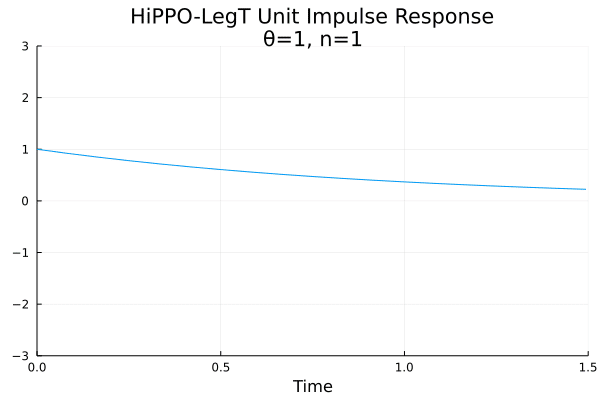

┌ Info: Saved animation to 
│   fn = /tmp/jl_PXyxdF.gif
└ @ Plots /home/beegass/.julia/packages/Plots/SkUg1/src/animation.jl:126


In [93]:
anim = @animate for i = 1:total_time
    # println("Iteration: ", i)
    A, B =  build_LegT(i, 1, theta);
    C, D = ones(1, i), zeros(1, )
    # display("text/plain", A)
    # display("text/plain", B)
    # display("text/plain", C)
    # display("text/plain", D)
    legt = cont_or_disc(A, B, C, D, step);
    y, t, x = impulse(legt, 1.5)
    plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=("HiPPO-LegT Unit Impulse Response\nθ=1, n="*string(i)), lab=nothing)
end

if gifbool
    gif(anim, "HiPPO-LegT_Unit_Impulse_Response-A.gif", fps = gif_fps);
else
    display(gif(anim));
end


**LegT - LMU**

Plots.AnimatedGif("/tmp/jl_pw9iQ7.gif")
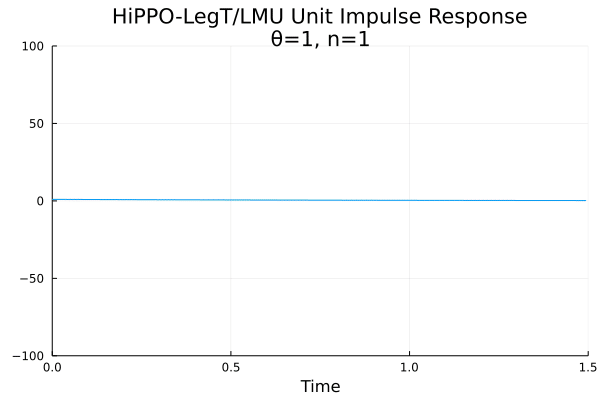

┌ Info: Saved animation to 
│   fn = /tmp/jl_pw9iQ7.gif
└ @ Plots /home/beegass/.julia/packages/Plots/SkUg1/src/animation.jl:126


In [94]:
anim = @animate for i = 1:total_time
    # println("Iteration: ", i)
    A, B =  build_LegT(i, 2, theta);
    C, D = ones(1, i), zeros(1, )
    # display("text/plain", A)
    # display("text/plain", B)
    # display("text/plain", C)
    # display("text/plain", D)
    legt = cont_or_disc(A, B, C, D, step);
    y, t, x = impulse(legt, 1.5)
    plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-100, 100), title=("HiPPO-LegT/LMU Unit Impulse Response\nθ=1, n="*string(i)), lab=nothing)
end

if gifbool
    gif(anim, "HiPPO-LegT_Unit_Impulse_Response-B.gif", fps = gif_fps);
else
    display(gif(anim));
end


## LegS

**LegS Discrete**

Plots.AnimatedGif("/tmp/jl_gJe2Q3.gif")
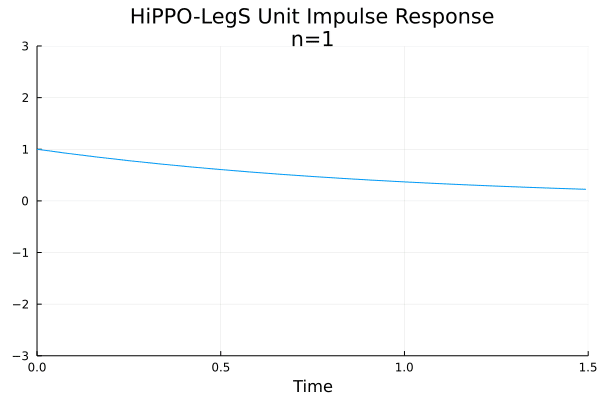

┌ Info: Saved animation to 
│   fn = /tmp/jl_gJe2Q3.gif
└ @ Plots /home/beegass/.julia/packages/Plots/SkUg1/src/animation.jl:126


In [95]:
anim = @animate for i = 1:total_time
    # println("Iteration: ", i)
    A, B =  build_LegS(i);
    C, D = ones(1, i), zeros(1, )
    # display("text/plain", A)
    # display("text/plain", B)
    # display("text/plain", C)
    # display("text/plain", D)
    legS = cont_or_disc(A, B, C, D, step);
    y, t, x = impulse(legS, 1.5)
    plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=("HiPPO-LegS Unit Impulse Response\nn="*string(i)), lab=nothing)
end

if gifbool
    gif(anim, "HiPPO-LegS_Unit_Impulse_Response-A.gif", fps = gif_fps);
else
    display(gif(anim));
end


## LagT

**LagT Discrete**

Plots.AnimatedGif("/tmp/jl_VHlvwr.gif")
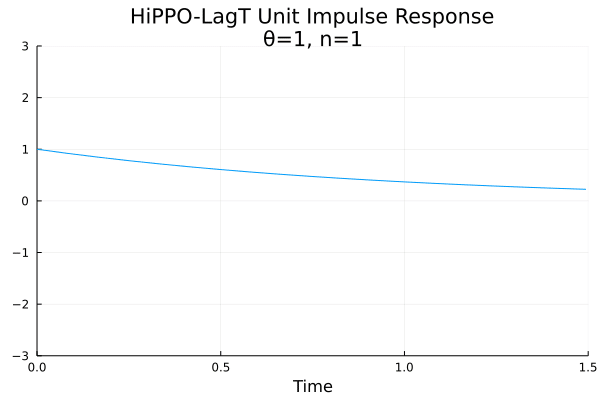

┌ Info: Saved animation to 
│   fn = /tmp/jl_VHlvwr.gif
└ @ Plots /home/beegass/.julia/packages/Plots/SkUg1/src/animation.jl:126


In [96]:
anim = @animate for i = 1:total_time
    # println("Iteration: ", i)
    A, B = build_LagT(i, 0, 1);
    C, D = ones(1, i), zeros(1, )
    # display("text/plain", A)
    # display("text/plain", B)
    # display("text/plain", C)
    # display("text/plain", D)
    lagT = cont_or_disc(A, B, C, D, step);
    y, t, x = impulse(lagT, 1.5)
    plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=("HiPPO-LagT Unit Impulse Response\nθ=1, n="*string(i)), lab=nothing)
end
if gifbool
    gif(anim, "HiPPO-LagT_Unit_Impulse_Response-A.gif", fps = gif_fps);
else
    display(gif(anim));
end


## Fourier

### Fourier Recurrent Unit (FRU)

In [97]:
anim = @animate for i = 1:total_time
    println("Iteration: ", i)
    A, B = build_Fourier(i, "fru");
    C, D = ones(1, i), zeros(1, )
    display("text/plain", A)
    display("text/plain", B)
    # display("text/plain", C)
    # display("text/plain", D)
    fru = cont_or_disc(A, B, C, D, step);
    y, t, x = impulse(fru, 1.5)
    plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=("HiPPO-FRU Unit Impulse Response\nθ=1, n="*string(i)), lab=nothing)
end
if gifbool
    gif(anim, "HiPPO-FRU_Unit_Impulse_Response.gif", fps = gif_fps);
else
    display(gif(anim));
end

Iteration: 1

MethodError: MethodError: no method matching rem(::Matrix{Int64}, ::Int64)
Closest candidates are:
  rem(::Any, ::Any, !Matched::RoundingMode{:ToZero}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:80
  rem(::Any, ::Any, !Matched::RoundingMode{:Down}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:81
  rem(::Any, ::Any, !Matched::RoundingMode{:Up}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:82
  ...

### Truncated Fourier (FouT)

In [98]:
anim = @animate for i = 1:total_time
    # println("Iteration: ", i)
    A, B = build_Fourier(i, "fout");
    C, D = ones(1, i), zeros(1, )
    # display("text/plain", A)
    # display("text/plain", B)
    # display("text/plain", C)
    # display("text/plain", D)
    fout = cont_or_disc(A, B, C, D, step);
    y, t, x = impulse(fout, 1.5)
    plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=("HiPPO-FouT Unit Impulse Response\nθ=1, n="*string(i)), lab=nothing)
end
if gifbool
    gif(anim, "HiPPO-FouT_Unit_Impulse_Response.gif", fps = gif_fps);
else
    display(gif(anim));
end

MethodError: MethodError: no method matching rem(::Matrix{Int64}, ::Int64)
Closest candidates are:
  rem(::Any, ::Any, !Matched::RoundingMode{:ToZero}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:80
  rem(::Any, ::Any, !Matched::RoundingMode{:Down}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:81
  rem(::Any, ::Any, !Matched::RoundingMode{:Up}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:82
  ...

### Fourier With Decay (FourD)

In [99]:
anim = @animate for i = 1:total_time
    # println("Iteration: ", i)
    A, B = build_Fourier(i, "fourd");
    C, D = ones(1, i), zeros(1, )
    # display("text/plain", A)
    # display("text/plain", B)
    # display("text/plain", C)
    # display("text/plain", D)
    fourd = cont_or_disc(A, B, C, D, step);
    y, t, x = impulse(fourd, 1.5)
    plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=("HiPPO-Fourier-Decay Unit Impulse Response\nθ=1, n="*string(i)), lab=nothing)
end
if gifbool
    gif(anim, "HiPPO-FourD_Unit_Impulse_Response.gif", fps = gif_fps);
else
    display(gif(anim));
end

MethodError: MethodError: no method matching rem(::Matrix{Int64}, ::Int64)
Closest candidates are:
  rem(::Any, ::Any, !Matched::RoundingMode{:ToZero}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:80
  rem(::Any, ::Any, !Matched::RoundingMode{:Down}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:81
  rem(::Any, ::Any, !Matched::RoundingMode{:Up}) at ~/.julia/juliaup/julia-1.7.3+0.x64/share/julia/base/div.jl:82
  ...

#### Interpolation between various HiPPO matrices impulse responses

In [100]:
hippo_one_C, hippo_one_D = Matrix{Float64}(I, N, N), zeros(1, )
hippo_two_C, hippo_two_D = Matrix{Float64}(I, N, N), zeros(1, )

([1.0 0.0 … 0.0 0.0; 0.0 1.0 … 0.0 0.0; … ; 0.0 0.0 … 1.0 0.0; 0.0 0.0 … 0.0 1.0], [0.0])

In [101]:
function impulse_interpolater(titl::Any, hippo_one_A::Any, hippo_one_B::Any, hippo_two_A::Any, hippo_two_B::Any)
    anim = @animate for i = 0:(1/100):1
        # println("Iteration: ", i)
    
        # display("HiPPO 1")
        # display("text/plain", hippo_one_A)
        # display("text/plain", hippo_one_B)
    
        # display("HiPPO 2")
        # display("text/plain", hippo_two_A)
        # display("text/plain", hippo_two_B)
        
        sys = ss(exp(i.*log(hippo_two_A*inv(hippo_one_A)))*hippo_one_A,(hippo_two_B.*i).+(hippo_one_B.*(1-i)),(hippo_two_C.*i).+(hippo_one_C.*(1-i)), 0);
        y, t, x = impulse(sys, 1.5);
        plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=(titl*string(i)), lab=nothing);
    end

    return anim
end

impulse_interpolater (generic function with 1 method)

legs -> legt

Plots.AnimatedGif("/tmp/jl_sgTTws.gif")
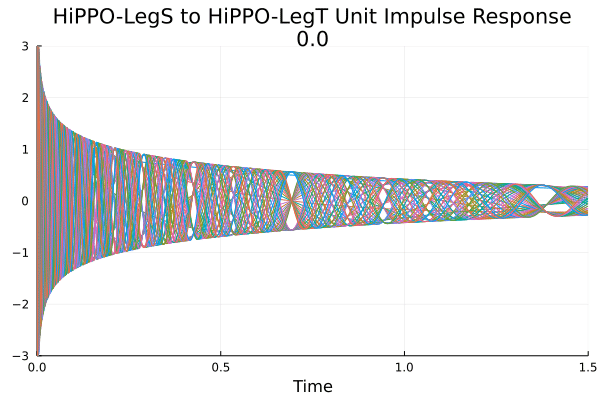

┌ Info: Saved animation to 
│   fn = /tmp/jl_sgTTws.gif
└ @ Plots /home/beegass/.julia/packages/Plots/SkUg1/src/animation.jl:126


In [102]:
legs_A, legs_B = build_LegS(N);
legt_A, legt_B = build_LegT(N, λ_n, theta);

titl = "HiPPO-LegS to HiPPO-LegT Unit Impulse Response\n"

anim = impulse_interpolater(titl, legs_A, legs_B, legt_A, legt_B)

if gifbool
    gif(anim, "HiPPO-LegS_to_HiPPO-LegT_Unit_Impulse_Response-A.gif", fps = gif_fps);
else
    display(gif(anim));
end

legs -> lagt

Plots.AnimatedGif("/tmp/jl_ZwlX99.gif")
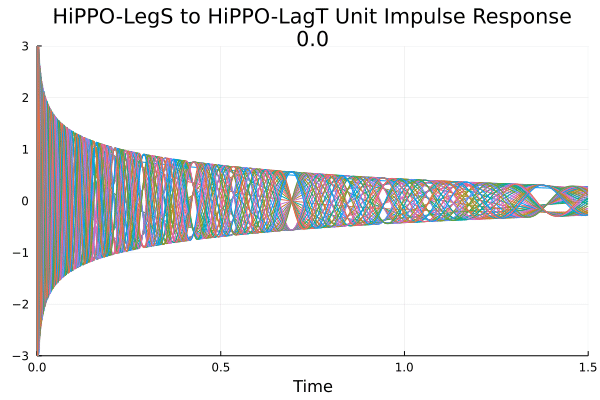

┌ Info: Saved animation to 
│   fn = /tmp/jl_ZwlX99.gif
└ @ Plots /home/beegass/.julia/packages/Plots/SkUg1/src/animation.jl:126


In [103]:
legs_A, legs_B = build_LegS(N);
lagt_A, lagt_B = build_LagT(N, alpha, beta);

titl = "HiPPO-LegS to HiPPO-LagT Unit Impulse Response\n"

anim = impulse_interpolater(titl, legs_A, legs_B, lagt_A, lagt_B)

if gifbool
    gif(anim, "HiPPO-LegS_to_HiPPO-LagT_Unit_Impulse_Response-B.gif", fps = gif_fps);
else
    display(gif(anim));
end

legt -> legs

Plots.AnimatedGif("/tmp/jl_sf8t6M.gif")
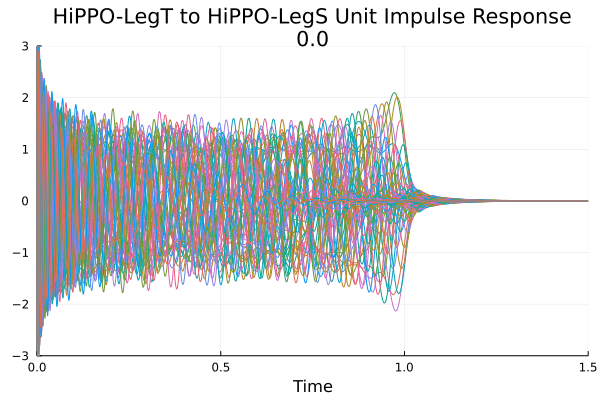

┌ Info: Saved animation to 
│   fn = /tmp/jl_sf8t6M.gif
└ @ Plots /home/beegass/.julia/packages/Plots/SkUg1/src/animation.jl:126


In [104]:
legs_A, legs_B = build_LegS(N);
legt_A, legt_B = build_LegT(N, λ_n, theta);

titl = "HiPPO-LegT to HiPPO-LegS Unit Impulse Response\n"

anim = impulse_interpolater(titl, legt_A, legt_B, legs_A, legs_B)

if gifbool
    gif(anim, "HiPPO-LegT_to_HiPPO-LegS_Unit_Impulse_Response-C.gif", fps = gif_fps);
else
    display(gif(anim));
end

legt -> lagt

In [105]:
legt_A, legt_B = build_LegT(N, λ_n, theta);
lagt_A, lagt_B = build_LagT(N, alpha, beta);

titl = "HiPPO-LegT to HiPPO-LagT Unit Impulse Response\n"

anim = impulse_interpolater(titl, legt_A, legt_B, lagt_A, lagt_B)

if gifbool
    gif(anim, "HiPPO-LegT_to_HiPPO-LagT_Unit_Impulse_Response-D.gif", fps = gif_fps);
else
    display(gif(anim));
end

lagt -> legt

In [ ]:
legt_A, legt_B = build_LegT(N, λ_n, theta);
lagt_A, lagt_B = build_LagT(N, alpha, beta);

titl = "HiPPO-LagT to HiPPO-LegT Unit Impulse Response\n"

anim = impulse_interpolater(titl, lagt_A, lagt_B, legt_A, legt_B)

if gifbool
    gif(anim, "HiPPO-LagT_to_HiPPO-LegT_Unit_Impulse_Response-E.gif", fps = gif_fps);
else
    display(gif(anim));
end

lagt -> legs

In [ ]:
legs_A, legs_B = build_LegS(N);
lagt_A, lagt_B = build_LagT(N, alpha, beta);

titl = "HiPPO-LagT to HiPPO-LegS Unit Impulse Response\n"

anim = impulse_interpolater(titl, lagt_A, lagt_B, legs_A, legs_B)

if gifbool
    gif(anim, "HiPPO-LagT_to_HiPPO-LegS_Unit_Impulse_Response-F.gif", fps = gif_fps);
else
    display(gif(anim));
end

#### Interpolation between various HiPPO matrices impulse responses

In [ ]:
function interpolater(titl::Any, hippo_one_A::Any, hippo_one_B::Any, hippo_two_A::Any, hippo_two_B::Any)
    anim = @animate for i = 0:(1/100):1
        # println("Iteration: ", i)
    
        hippo_one_C, hippo_one_D = Matrix{Float64}(I, N, N), zeros(1, )
        hippo_two_C, hippo_two_D = Matrix{Float64}(I, N, N), zeros(1, )
    
        # display("HiPPO 1")
        # display("text/plain", hippo_one_A)
        # display("text/plain", hippo_one_B)
    
        # display("HiPPO 2")
        # display("text/plain", hippo_two_A)
        # display("text/plain", hippo_two_B)
        
        sys = ss(exp(i.*log(hippo_two_A*inv(hippo_one_A)))*hippo_one_A,(hippo_two_B.*i).+(hippo_one_B.*(1-i)),(hippo_two_C.*i).+(hippo_one_C.*(1-i)), 0);
        y, t, x = impulse(sys, 1.5);
        plot(t,x', xlabel="Time", xlims=(0, 1.5), ylimit=(-3, 3), title=(titl*string(i)), lab=nothing);
    end

    return anim
end